### Checking NVIDIA GPU Status

In [1]:
!nvidia-smi

Thu Jul 18 06:28:12 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   67C    P8              11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

### Installing Specific Versions of Ultralytics and Roboflow Libraries

In [2]:

%%capture
!pip install ultralytics==8.0.196
!pip install roboflow

###Import Libraries

In [3]:
import os
from IPython import display
import ultralytics
from ultralytics import YOLO
from IPython.display import display, Image
from roboflow import Roboflow
from google.colab import drive
import itertools
import glob
import json

###Setting the Home Directory

In [4]:
HOME = os.getcwd()
print(HOME)

/content


### Checking Ultralytics

In [5]:
ultralytics.checks()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 30.1/78.2 GB disk)


###Downloading YOLOv8 Object Detection Dataset using Roboflow API

In [6]:
rf = Roboflow(api_key="5AYKbygCi5IOpsIwX71T")
project = rf.workspace("new-amina").project("object-detection-new-amina-dina")
version = project.version(17)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to object-detection-new-amina-dina-17 in yolov8:: 100%|██████████| 1920/1920 [00:00<00:00, 4896.56it/s]


###Baseline

In [7]:
%cd {HOME}

!yolo task = detect mode=train model=yolov8s.pt data=/content/object-detection-new-amina-dina-17/data.yaml epochs=50 plots=True

/content
100% 21.5M/21.5M [00:00<00:00, 453MB/s]
New https://pypi.org/project/ultralytics/8.2.59 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/object-detection-new-amina-dina-17/data.yaml, epochs=50, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=

###Confusion Matrix

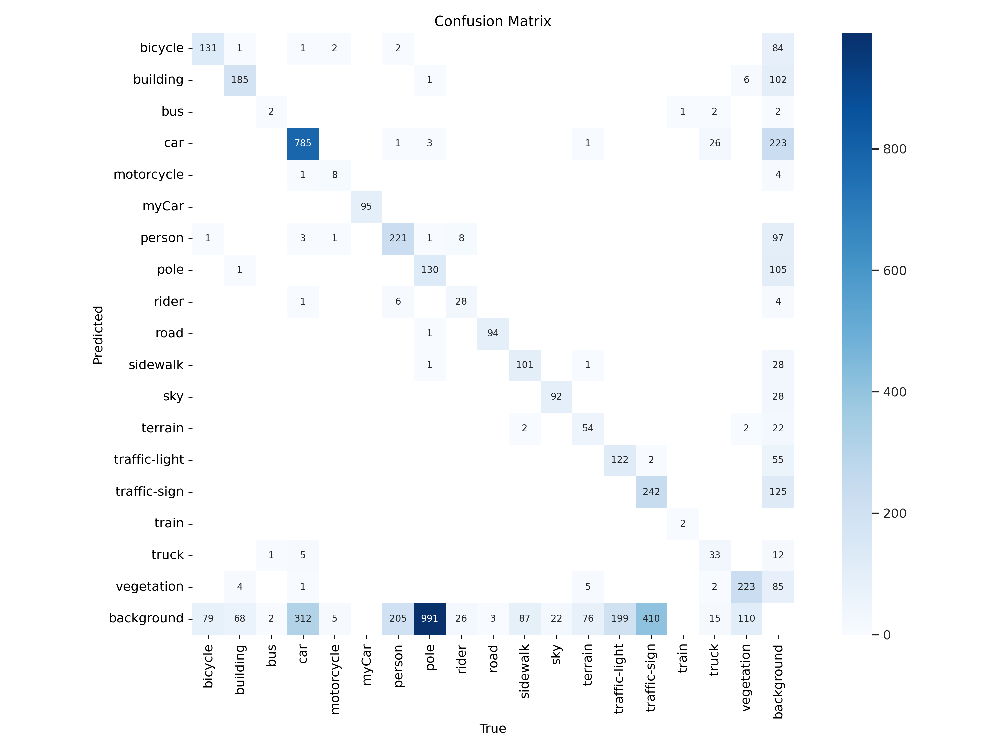

In [8]:
Image(filename="/content/runs/detect/train/confusion_matrix.png", width=800)

###Hyperparameter Tuning for YOLOv8 Object Detection Model using Grid Search

---



In [ ]:
param_grid = {
    'iou': [0.5, 0.7, 0.8],
    'conf': [0.25, 0.5, 0.75]
}

# Generate combinations
param_combinations = list(itertools.product(*param_grid.values()))

best_map = 0
best_params = {}
all_results=[]
# Evaluate each combination
for combination in param_combinations:
    params = dict(zip(param_grid.keys(), combination))

    print("=======================================params================================================================: ", params)
    model = YOLO('yolov8s.pt')
    results = model.train(data='/content/object-detection-new-amina-dina-17/data.yaml', epochs=20, **params)

    # Store the results for the current combination
    result_entry = {
        'params': params,
        'mAP50': results.results_dict['metrics/mAP50(B)']
    }
    all_results.append(result_entry)
    if results.results_dict['metrics/mAP50(B)'] > best_map:
        best_map = results.results_dict['metrics/mAP50(B)']
        best_params = params

print("Best mAP: {:.4f} with Parameters: {}".format(best_map, best_params))
print("All results : " , all_results)


=======================================params================================================================:  {'iou': 0.5, 'conf': 0.25}


100%|██████████| 21.5M/21.5M [00:00<00:00, 262MB/s]
New https://pypi.org/project/ultralytics/8.2.58 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/object-detection-new-amina-dina-17/data.yaml, epochs=20, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=0.25, iou=0.5, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stri

=======================================params================================================================:  {'iou': 0.5, 'conf': 0.5}


New https://pypi.org/project/ultralytics/8.2.58 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/object-detection-new-amina-dina-17/data.yaml, epochs=20, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=0.5, iou=0.5, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize

=======================================params================================================================:  {'iou': 0.5, 'conf': 0.75}


New https://pypi.org/project/ultralytics/8.2.58 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/object-detection-new-amina-dina-17/data.yaml, epochs=20, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=0.75, iou=0.5, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualiz

=======================================params================================================================:  {'iou': 0.7, 'conf': 0.25}


New https://pypi.org/project/ultralytics/8.2.58 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/object-detection-new-amina-dina-17/data.yaml, epochs=20, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=0.25, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualiz

=======================================params================================================================:  {'iou': 0.7, 'conf': 0.5}


New https://pypi.org/project/ultralytics/8.2.58 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/object-detection-new-amina-dina-17/data.yaml, epochs=20, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=0.5, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize

=======================================params================================================================:  {'iou': 0.7, 'conf': 0.75}


  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256, 512, 3, 2]              
  8                  -1  1   1838080  ultralytics.nn.modules.block.C2f             [512, 512, 1, True]           
  9                  -1  1    656896  ultralytics.nn.modules.block.SPPF            [512,

=======================================params================================================================:  {'iou': 0.8, 'conf': 0.25}


Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/object-detection-new-amina-dina-17/data.yaml, epochs=20, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=0.25, iou=0.8, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torc

=======================================params================================================================:  {'iou': 0.8, 'conf': 0.5}


New https://pypi.org/project/ultralytics/8.2.58 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/object-detection-new-amina-dina-17/data.yaml, epochs=20, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=0.5, iou=0.8, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize

=======================================params================================================================:  {'iou': 0.8, 'conf': 0.75}


New https://pypi.org/project/ultralytics/8.2.58 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/object-detection-new-amina-dina-17/data.yaml, epochs=20, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=0.75, iou=0.8, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualiz

Best mAP: 0.6663 with Parameters: {'iou': 0.5, 'conf': 0.25}
All results :  [{'params': {'iou': 0.5, 'conf': 0.25}, 'mAP50': 0.6662987135285957}, {'params': {'iou': 0.5, 'conf': 0.5}, 'mAP50': 0.6454648238157078}, {'params': {'iou': 0.5, 'conf': 0.75}, 'mAP50': 0.6089785504106336}, {'params': {'iou': 0.7, 'conf': 0.25}, 'mAP50': 0.6537199310177694}, {'params': {'iou': 0.7, 'conf': 0.5}, 'mAP50': 0.6377677938684162}, {'params': {'iou': 0.7, 'conf': 0.75}, 'mAP50': 0.6089284864567381}, {'params': {'iou': 0.8, 'conf': 0.25}, 'mAP50': 0.636247196616153}, {'params': {'iou': 0.8, 'conf': 0.5}, 'mAP50': 0.6372268721682165}, {'params': {'iou': 0.8, 'conf': 0.75}, 'mAP50': 0.6089284864567381}]


###Training YOLOv8 Object Detection Model with Cityscape Dataset and The Best Hyperparameters (iou=0.5 conf=0.25)

In [ ]:
%cd {HOME}

!yolo task = detect mode=train model=yolov8s.pt data=/content/object-detection-new-amina-dina-17/data.yaml epochs=50 imgsz=800 plots=True iou=0.5 conf=0.25

/content
100% 21.5M/21.5M [00:00<00:00, 242MB/s]
New https://pypi.org/project/ultralytics/8.2.55 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/object-detection-new-amina-dina-17/data.yaml, epochs=50, patience=50, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=0.25, iou=0.5, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=

###Confusion Matrix

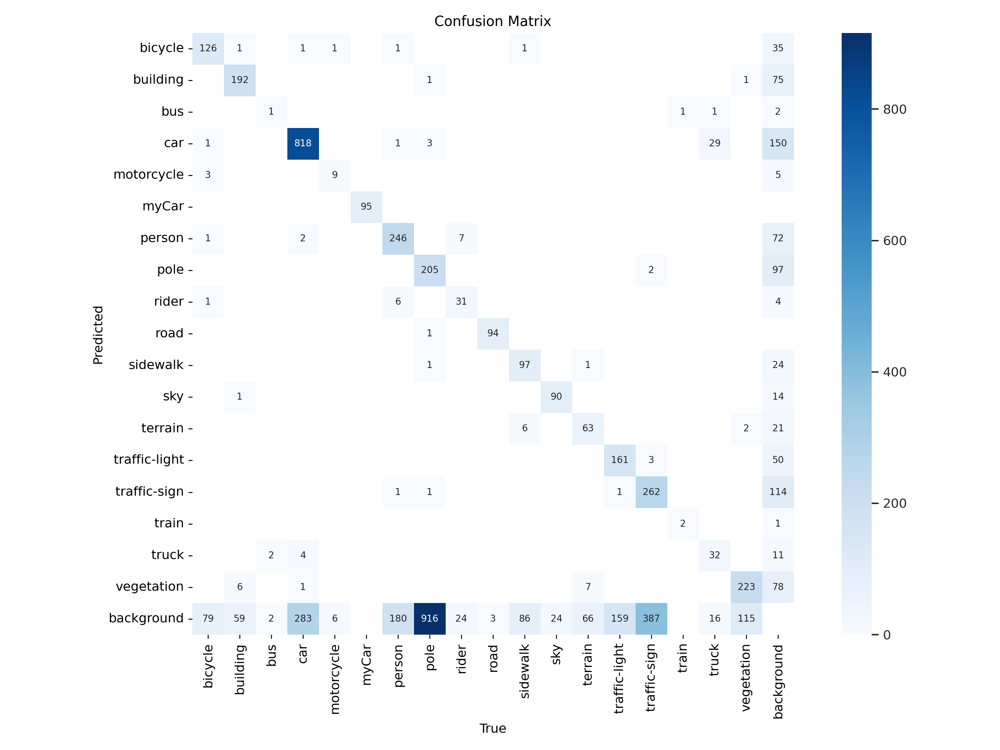

In [ ]:
Image(filename="/content/runs/detect/train/confusion_matrix.png", width=800)

###Running YOLOv8 Object Detection Model on Test Images and Saving Predictions

In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt iou=0.5 conf=0.25 source=/content/object-detection-new-amina-dina-17/test/images save=True

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11132550 parameters, 0 gradients, 28.5 GFLOPs

image 1/41 /content/object-detection-new-amina-dina-17/test/images/MnDOT-traffic-signals-at-intersection_jpg.rf.e9c64e1e5c80ac3a5edbeec6e933915a.jpg: 800x800 2 buildings, 4 cars, 1 person, 7 poles, 1 road, 1 sidewalk, 1 sky, 3 terrains, 10 traffic-lights, 5 traffic-signs, 3 trucks, 2 vegetations, 22.6ms
image 2/41 /content/object-detection-new-amina-dina-17/test/images/bfe07cf7-28db-44f1-ac2c-6e90c8008ed7-largeScale_MetroPolice_2_jpg.rf.efc6a8a655d56c6f178f52d0493465a3.jpg: 800x800 7 cars, 1 person, 4 poles, 1 road, 1 sky, 2 terrains, 2 traffic-lights, 4 traffic-signs, 1 truck, 4 vegetations, 22.6ms
image 3/41 /content/object-detection-new-amina-dina-17/test/images/bremen_000054_000019_leftImg8bit_png.rf.ef41a165ac9abc793296f65766af1e42.jpg: 800x800 4 bicycles, 2 buildings, 3 cars, 1 motorcycle, 1 myCar, 6 per

###Displaying Predicted Images from YOLOv8 Object Detection Model

/content/runs/detect/predict/germany_road_28_png.rf.70769075f0803a201434511961c840e9.jpg


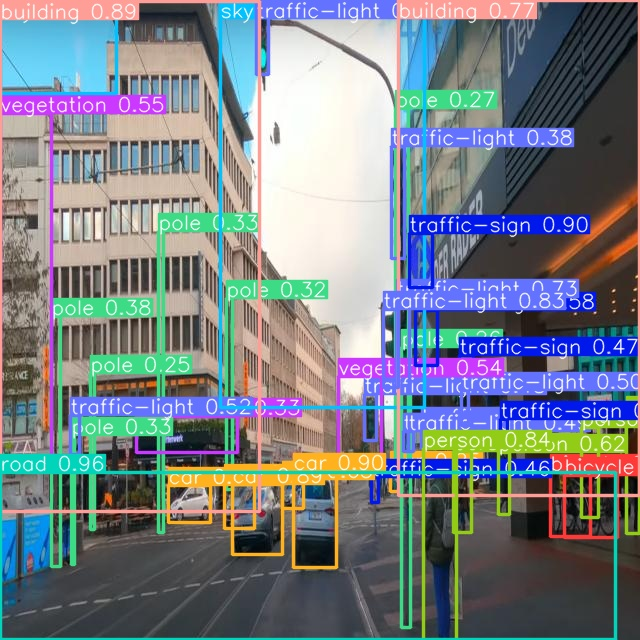



/content/runs/detect/predict/germany_road_33_png.rf.0ce05603bbd1876abf2404cf7fac06e7.jpg


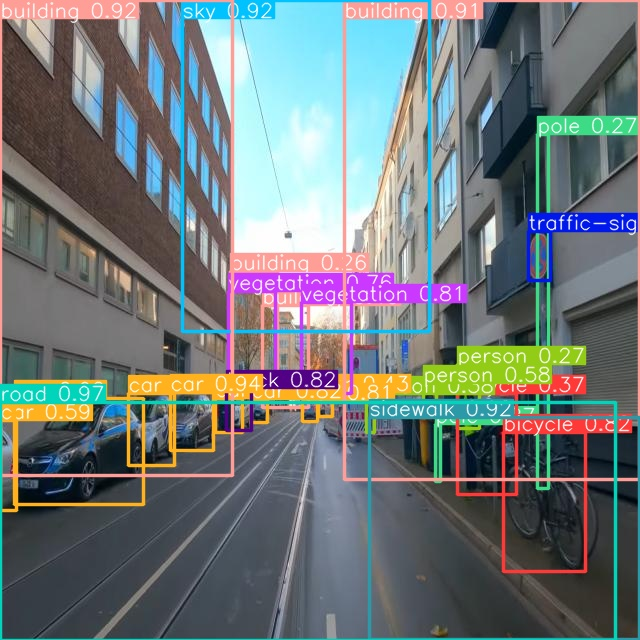



/content/runs/detect/predict/MnDOT-traffic-signals-at-intersection_jpg.rf.e9c64e1e5c80ac3a5edbeec6e933915a.jpg


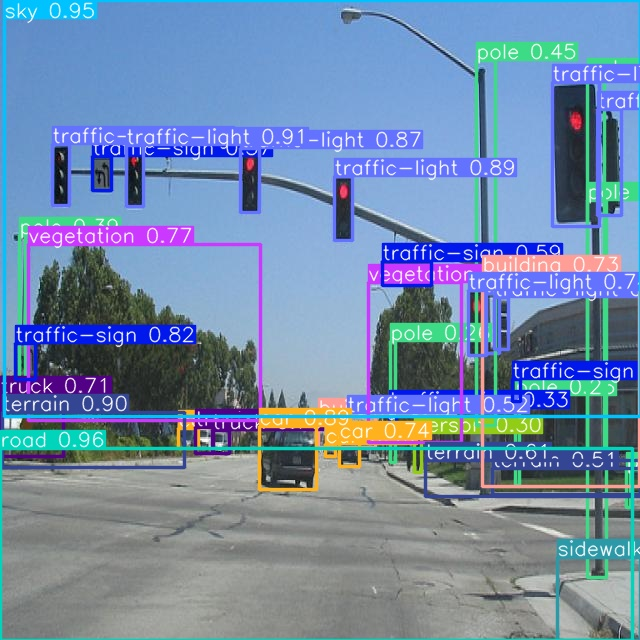



/content/runs/detect/predict/dusseldorf_000166_000019_leftImg8bit_png.rf.f8a91eaa712cc54a9079eb3468cf23ce.jpg


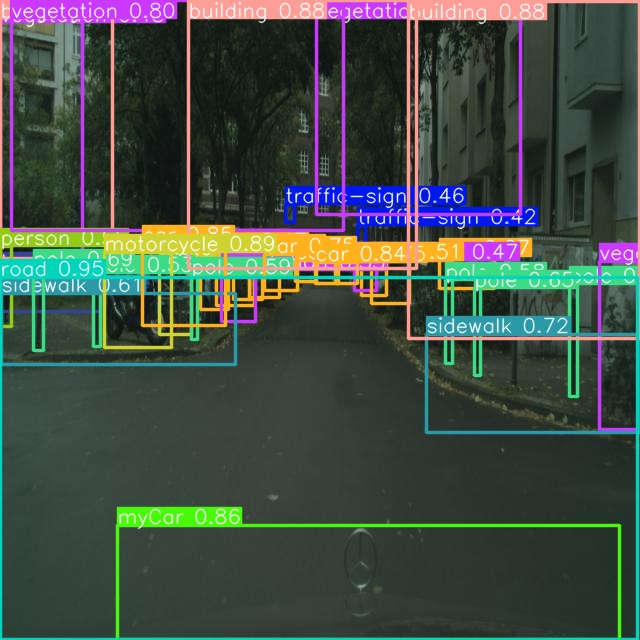



/content/runs/detect/predict/dry00024_jpg.rf.5f8d8ad7136866ac4d9db5d64212f888.jpg


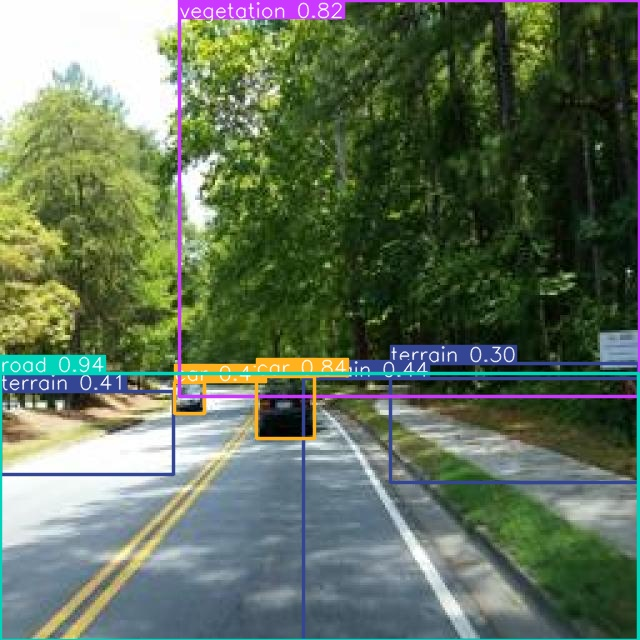



/content/runs/detect/predict/germany_road_29_png.rf.edca1342cb86b80541cef84c5fa683d2.jpg


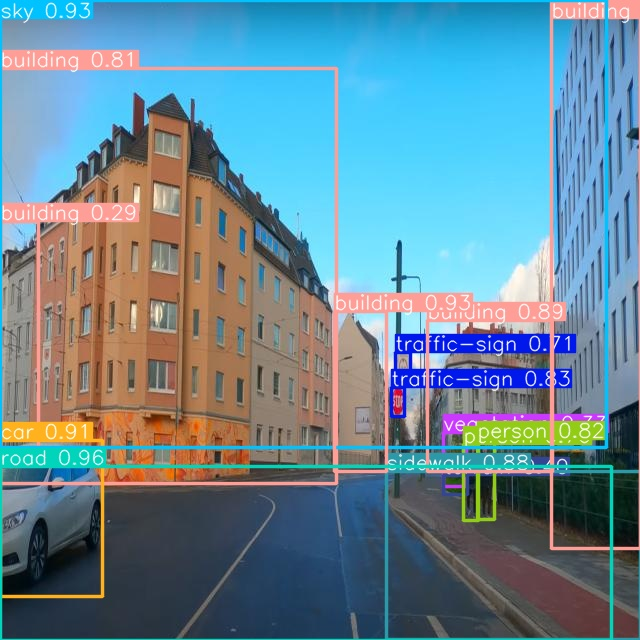



/content/runs/detect/predict/stuttgart_000185_000019_leftImg8bit_png.rf.737e2b577095fd3388820fab3ebb0837.jpg


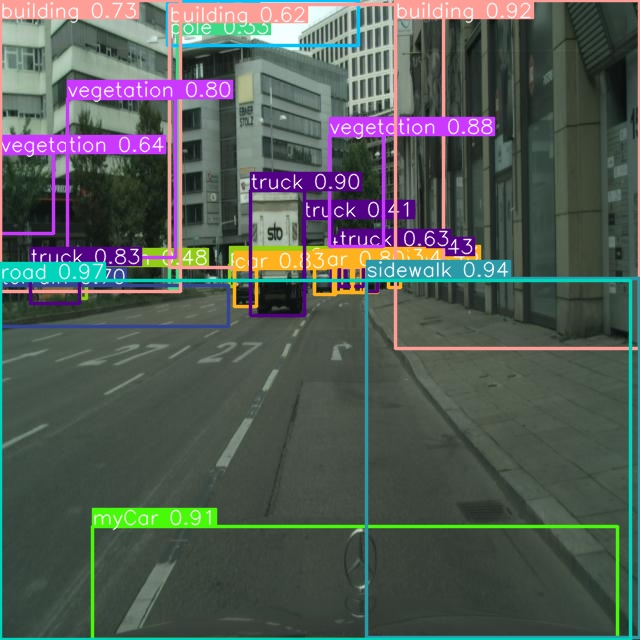



/content/runs/detect/predict/stuttgart_000131_000019_leftImg8bit_png.rf.230c857a3bfbd53dca26bfe1c8cd701f.jpg


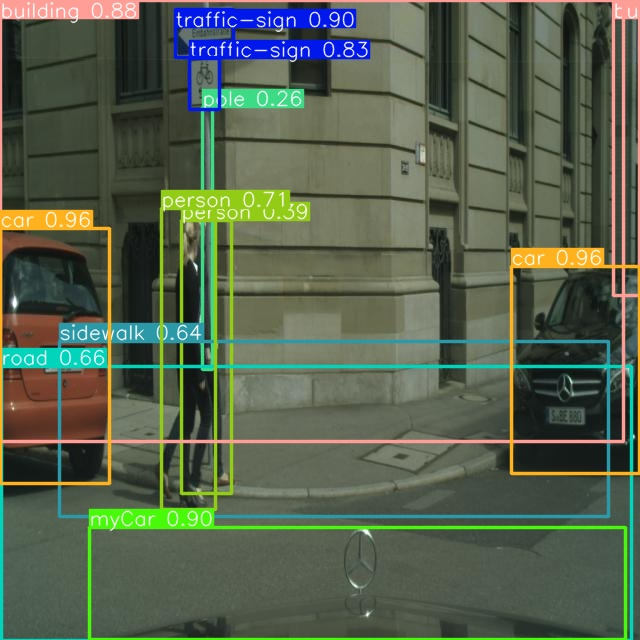



/content/runs/detect/predict/dry00002_jpg.rf.c8603cee71dfaee3c6d47e7bead53b26.jpg


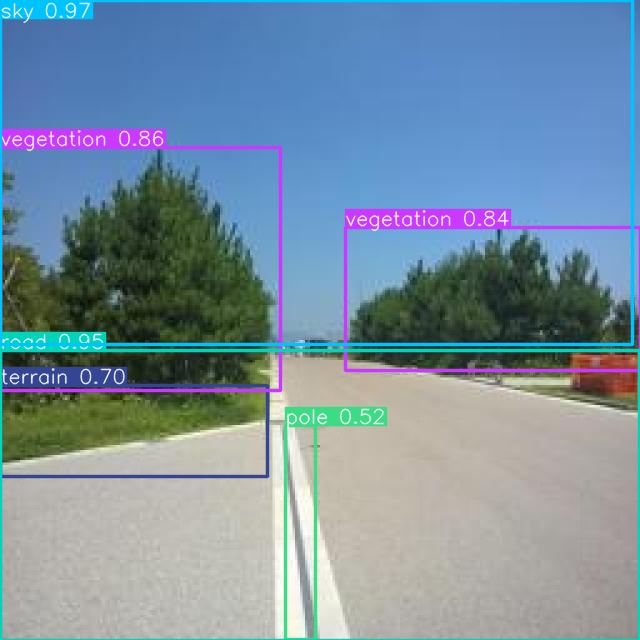



/content/runs/detect/predict/dry00004_jpg.rf.50ef5e27168a91321227f3bc49b29b0f.jpg


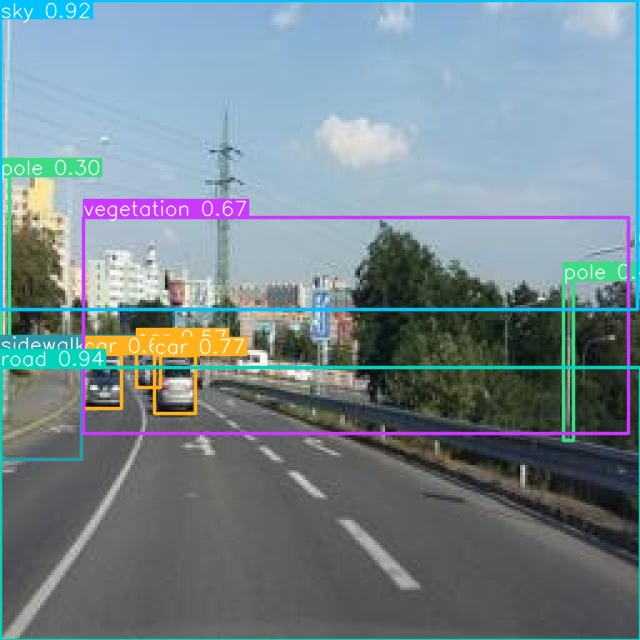



/content/runs/detect/predict/stuttgart_000062_000019_leftImg8bit_png.rf.87ad3d696002f50767e61c51720b595f.jpg


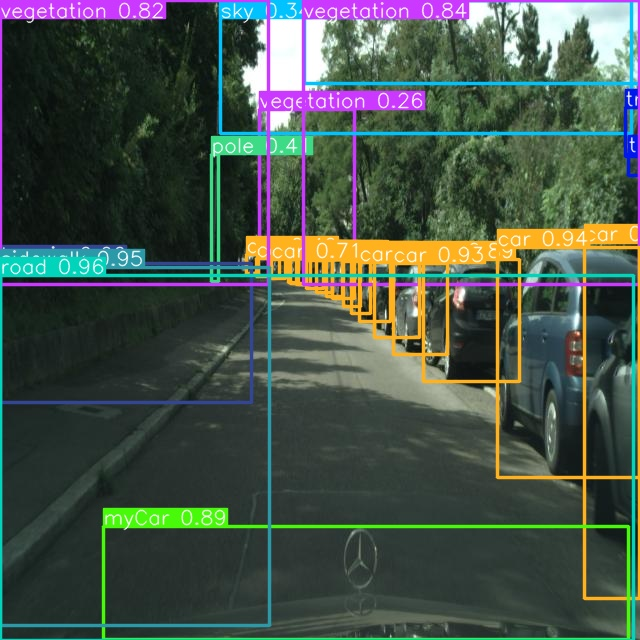



/content/runs/detect/predict/germany_road_3_png.rf.1c98954653d133329efe790a4a4d39b1.jpg


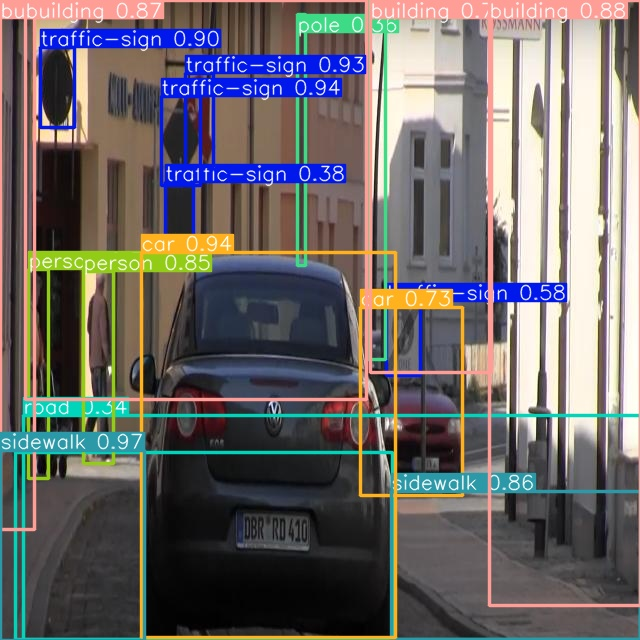



/content/runs/detect/predict/dry00062_jpg.rf.496f50afad152d963b471dddc915388e.jpg


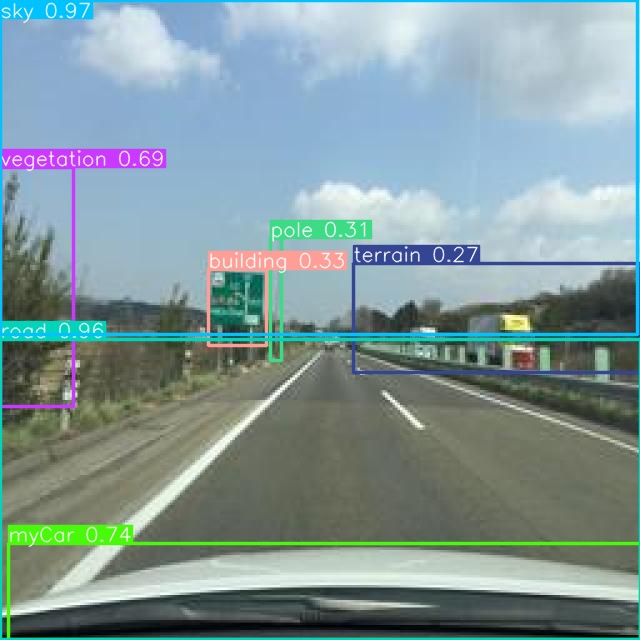



/content/runs/detect/predict/dry00052_jpg.rf.54d5b06c635c2d9890b5035623871e9c.jpg


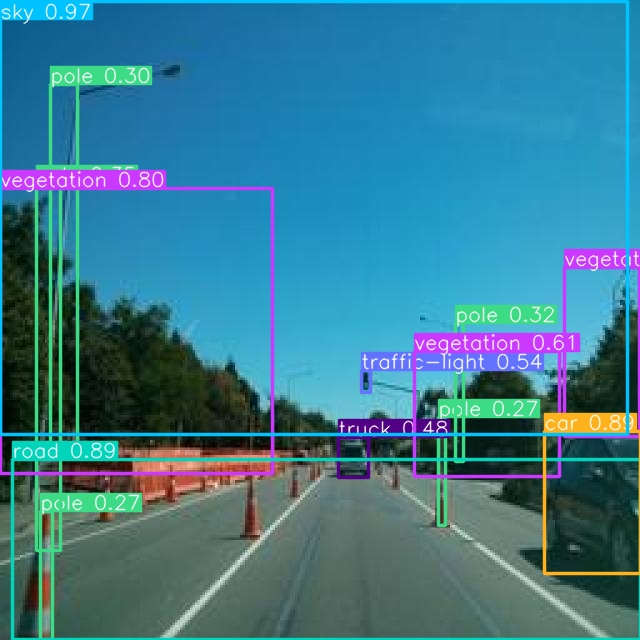



/content/runs/detect/predict/germany_road_34_png.rf.95150d2b37c7290b11d76104fdb458a3.jpg


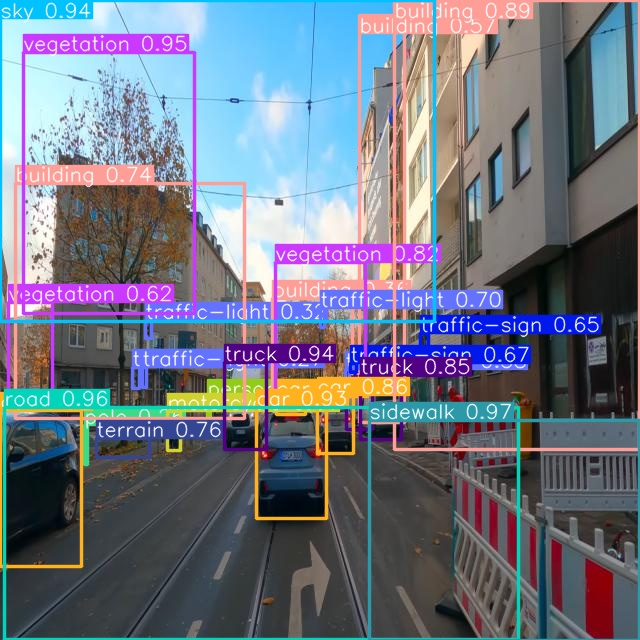



/content/runs/detect/predict/monchengladbach_000000_002255_leftImg8bit_png.rf.20d6f5ea9ced39f09bbdeb84eef51588.jpg


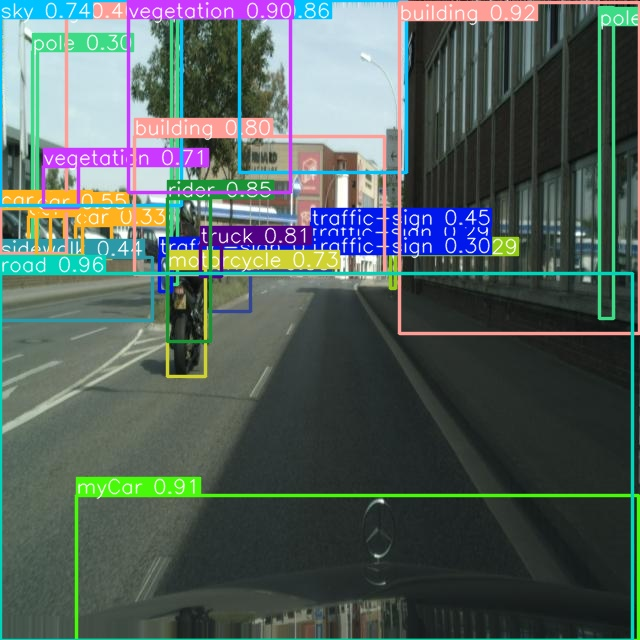



/content/runs/detect/predict/dry00053_jpg.rf.3f5ae0bbcdca4fc6868b29a4d0d24ef8.jpg


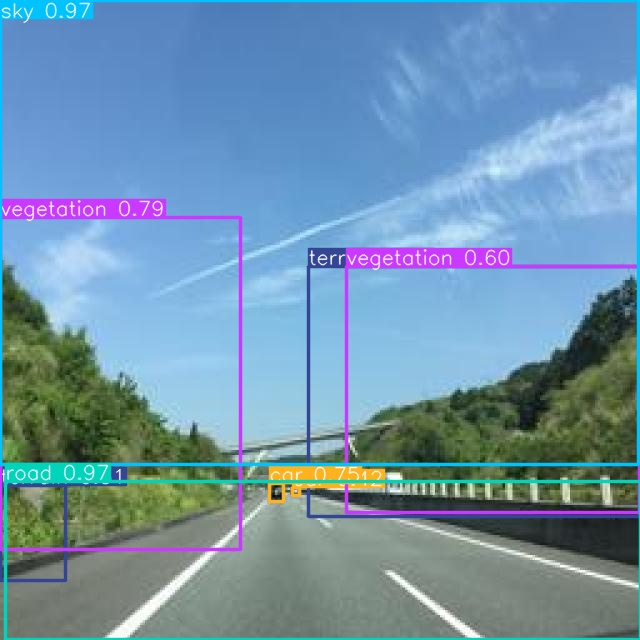



/content/runs/detect/predict/germany_road_32_png.rf.bd11f4a5ce1ab7c570f4768d1a1fef0e.jpg


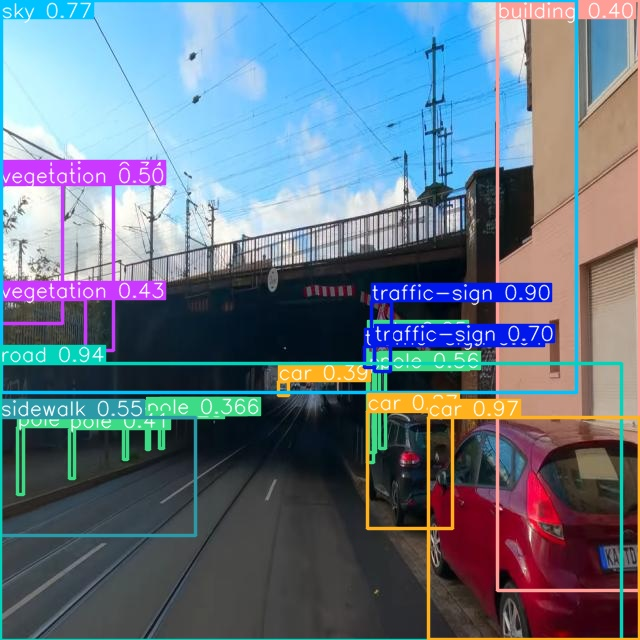



/content/runs/detect/predict/dusseldorf_000149_000019_leftImg8bit_png.rf.d18d90802a10af0ca882fdb7e7ca88cf.jpg


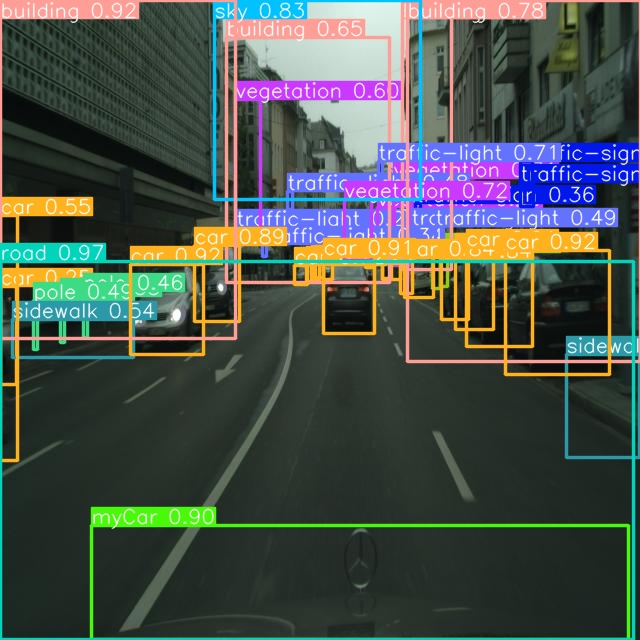



/content/runs/detect/predict/dry00076_jpg.rf.7dafb2ed96259df4f1ac7d8b9038769c.jpg


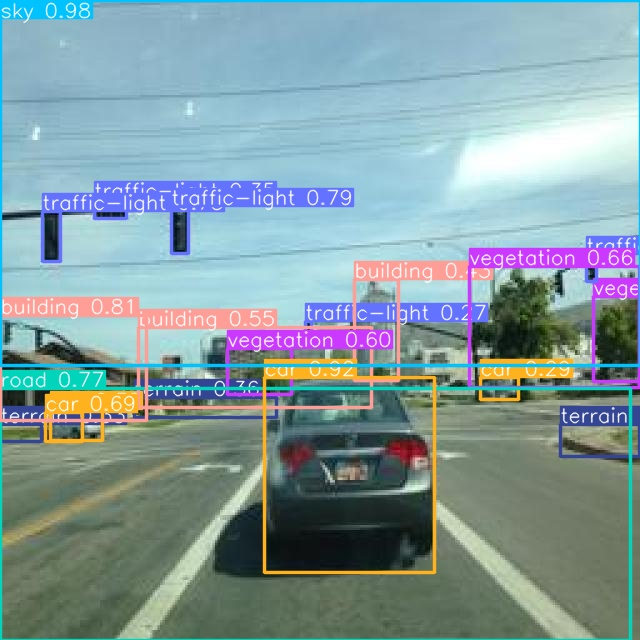



/content/runs/detect/predict/jena_000101_000019_leftImg8bit_png.rf.2a2b1d45b4d4f6302dff5bdbc53c1dea.jpg


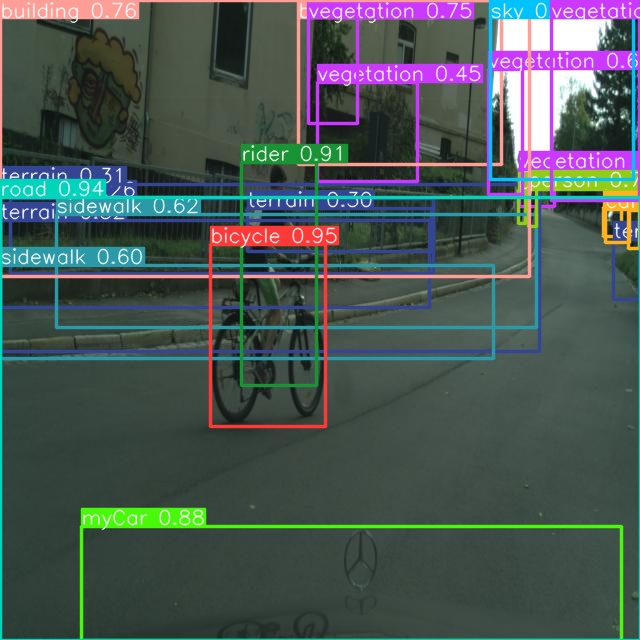



/content/runs/detect/predict/bremen_000054_000019_leftImg8bit_png.rf.ef41a165ac9abc793296f65766af1e42.jpg


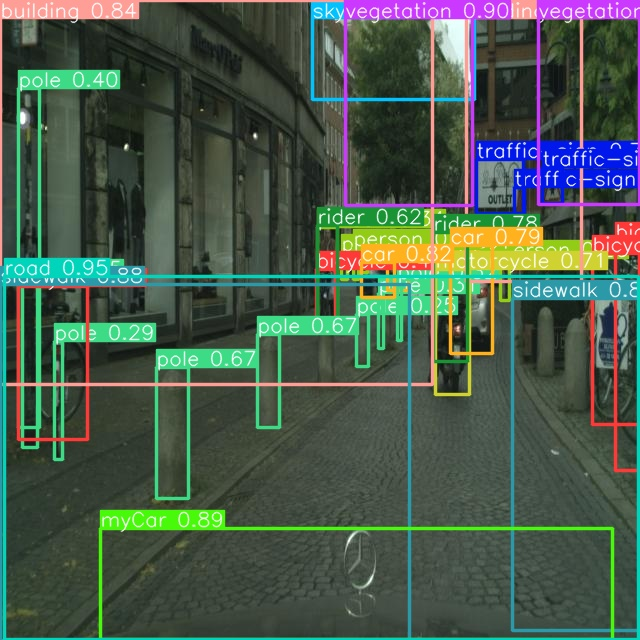



/content/runs/detect/predict/stuttgart_000176_000019_leftImg8bit_png.rf.7409fe2f39747972cc96d29fc40a5975.jpg


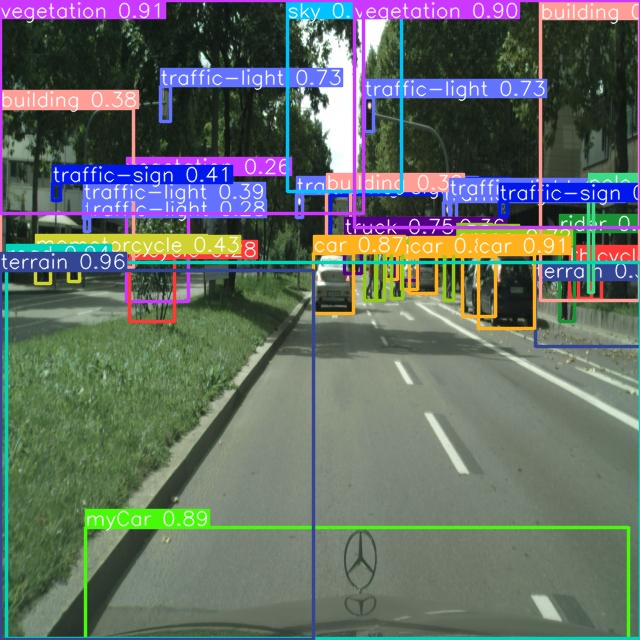



/content/runs/detect/predict/stuttgart_000112_000019_leftImg8bit_png.rf.49e1b19e1815eb8a29908e3f2788b93e.jpg


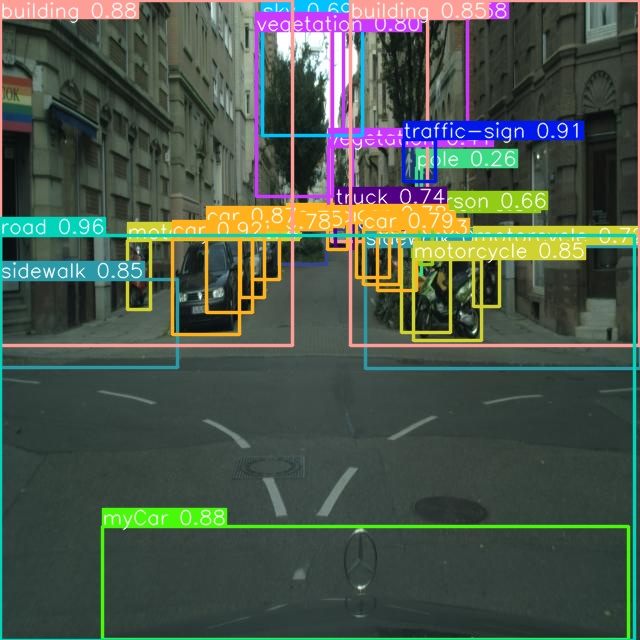



/content/runs/detect/predict/n04335435_15249_JPEG.rf.49da1c92c2e53616bc680354a21abc53.jpg


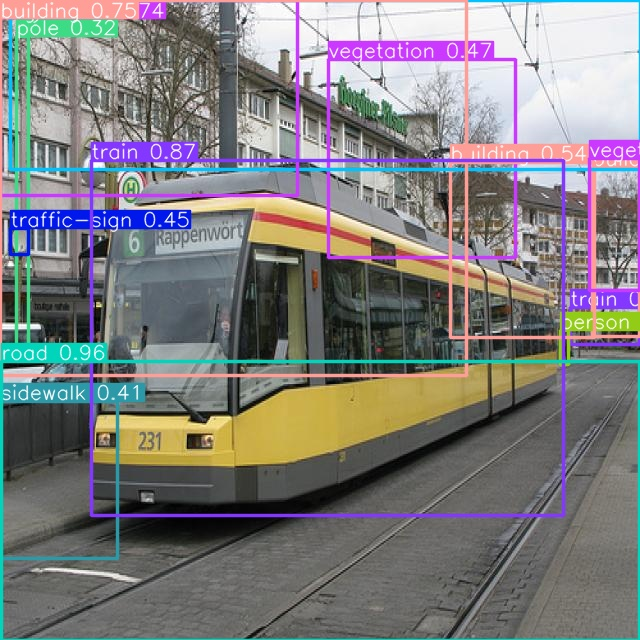



/content/runs/detect/predict/germany_road_31_png.rf.c86cab3fa063728475bd0eee0cf5511a.jpg


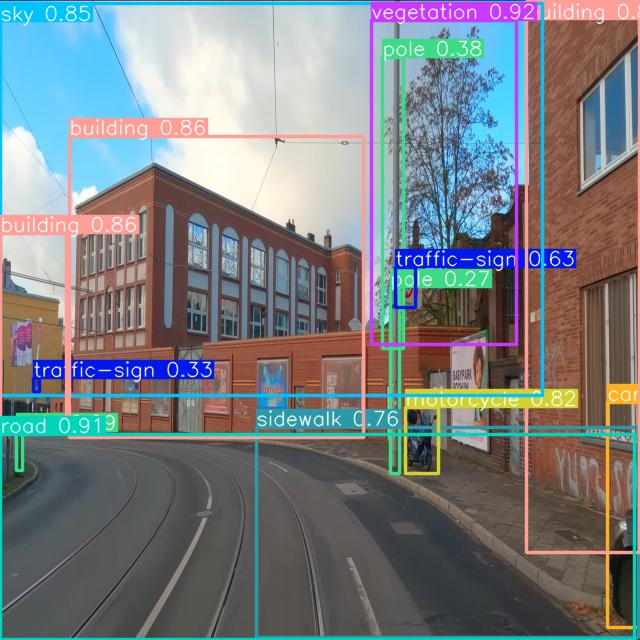



/content/runs/detect/predict/dry00037_jpg.rf.51ce55eeec485a105c83d319c4ba185c.jpg


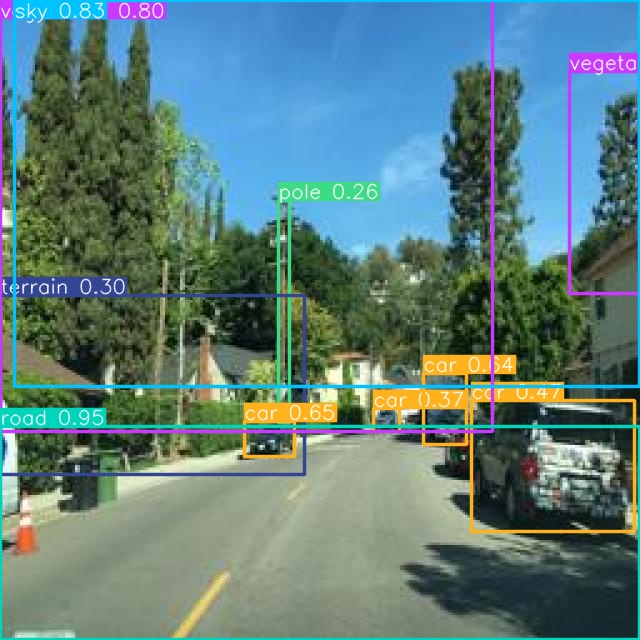



/content/runs/detect/predict/ulm_000072_000019_leftImg8bit_png.rf.c8303a4ee21327bc3366638ccfae83bc.jpg


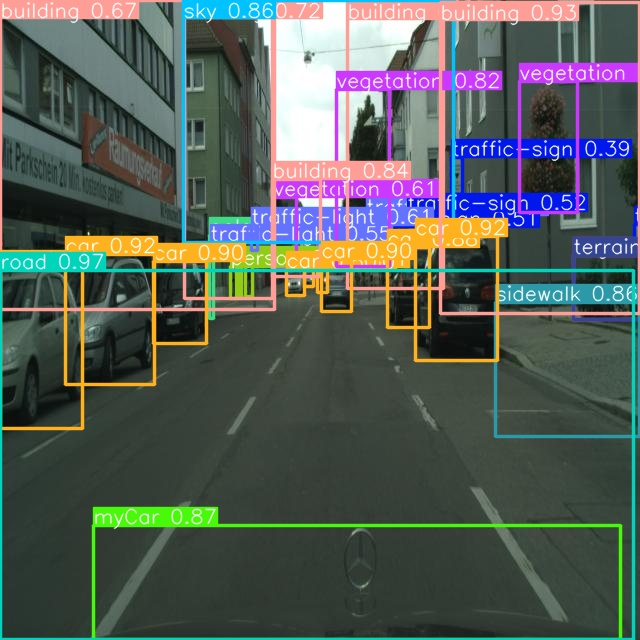



/content/runs/detect/predict/darmstadt_000078_000019_leftImg8bit_png.rf.1e949e208b829b80148a7a197f6b636a.jpg


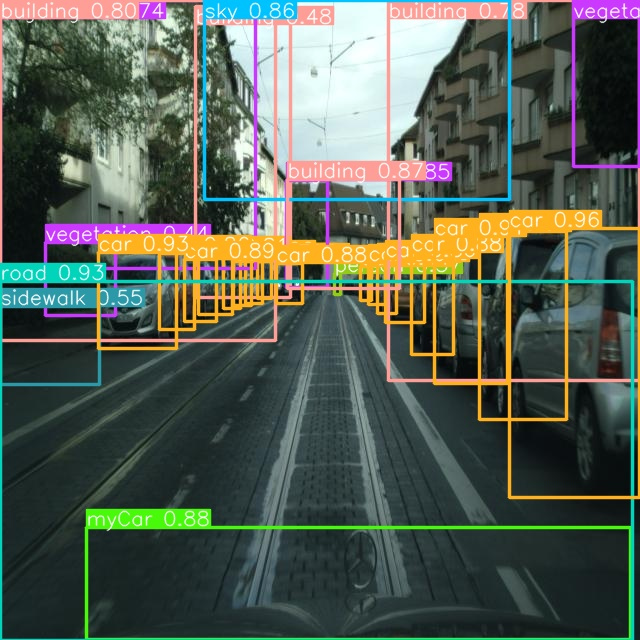



/content/runs/detect/predict/darmstadt_000000_000019_leftImg8bit_png.rf.569aa18d2d5fe705f0182ed7b49c0e40.jpg


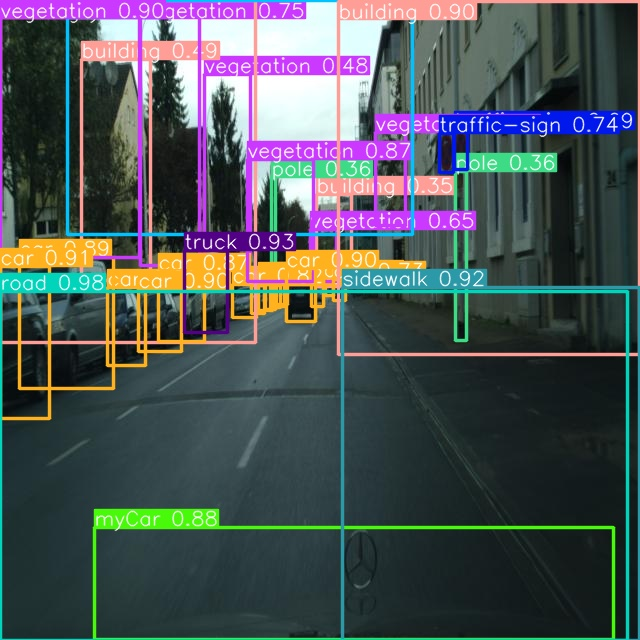



/content/runs/detect/predict/dry00039_jpg.rf.99eadcc0d7c7553c0f05f4a7200afa73.jpg


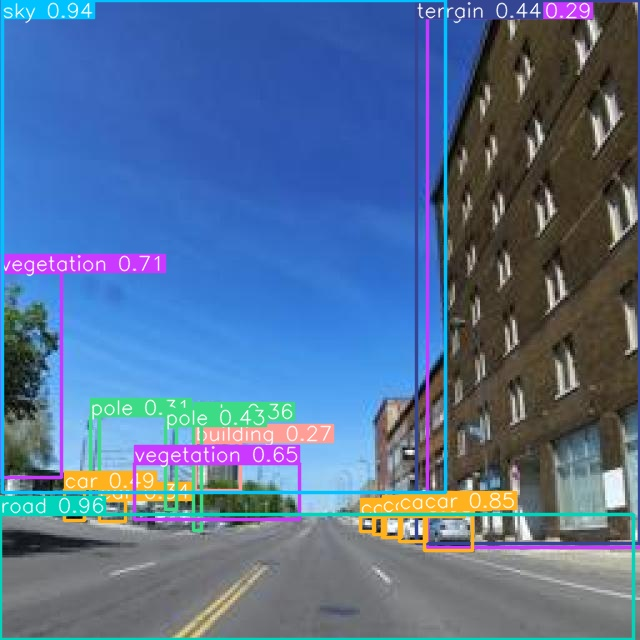



/content/runs/detect/predict/bfe07cf7-28db-44f1-ac2c-6e90c8008ed7-largeScale_MetroPolice_2_jpg.rf.efc6a8a655d56c6f178f52d0493465a3.jpg


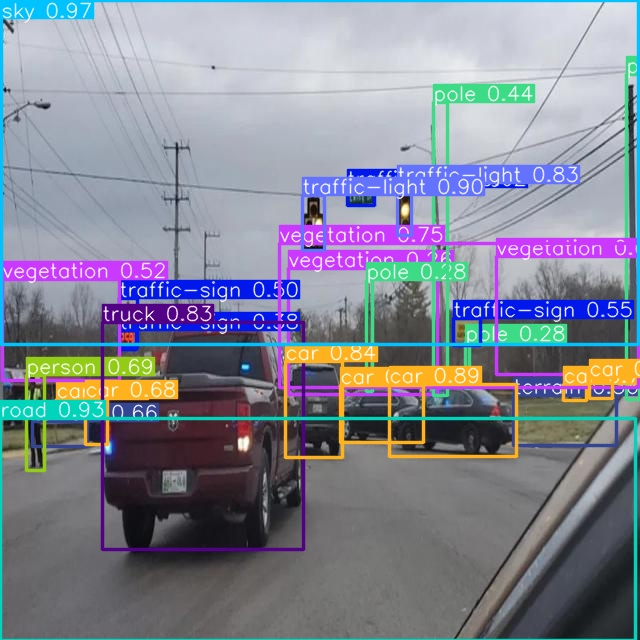



/content/runs/detect/predict/dry00028_jpg.rf.80cf46e7302aa1579f6f7729a5ddb964.jpg


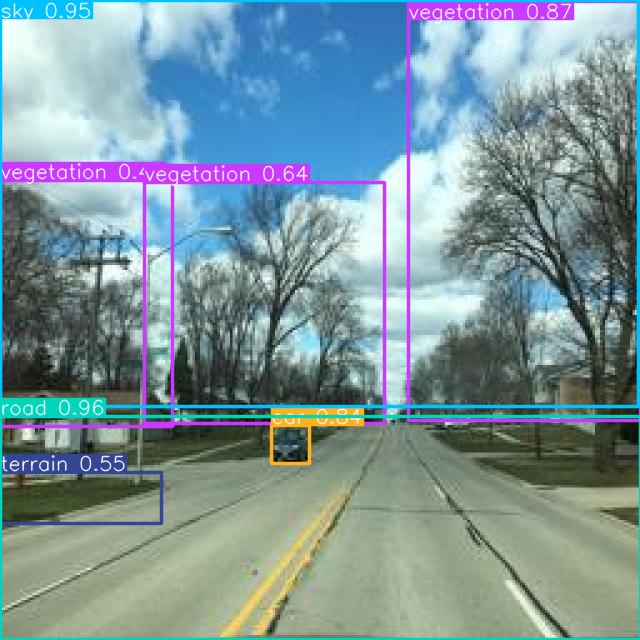



/content/runs/detect/predict/dry00081_jpg.rf.f3d1ac1b69246017c71e0db3193f3615.jpg


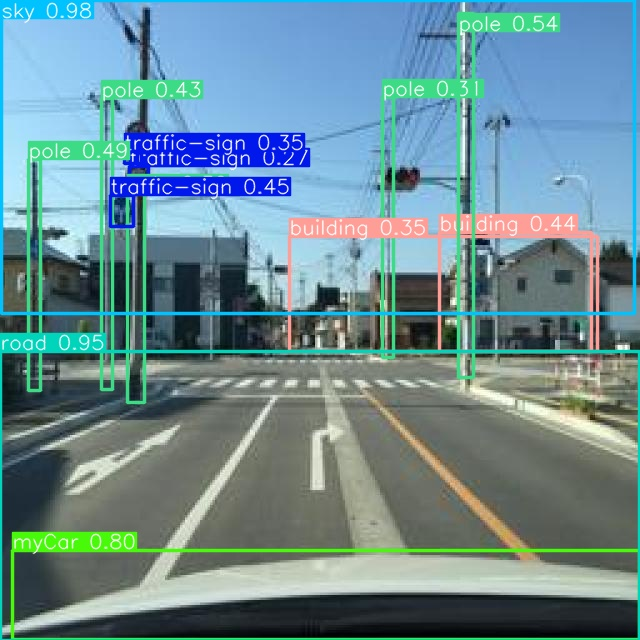



/content/runs/detect/predict/darmstadt_000009_000019_leftImg8bit_png.rf.d94dff26c263f3c991c29c4aaf0cbeb0.jpg


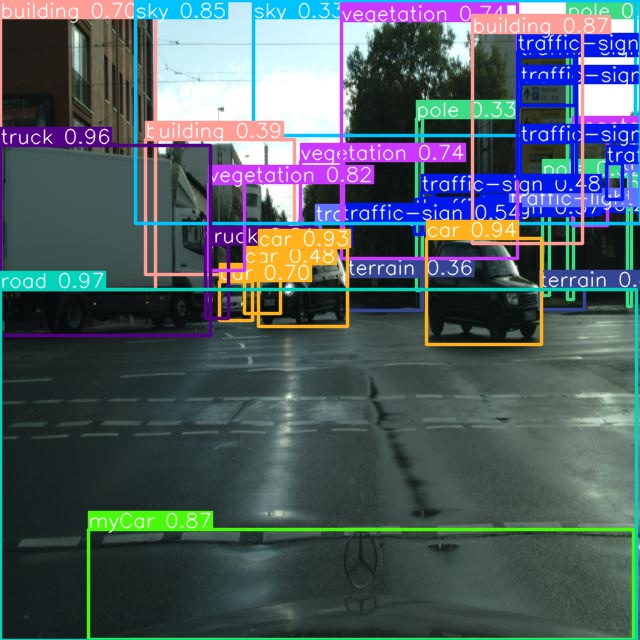



/content/runs/detect/predict/dry00065_jpg.rf.d9a457432b26d63b7b8cc3696f1d2b81.jpg


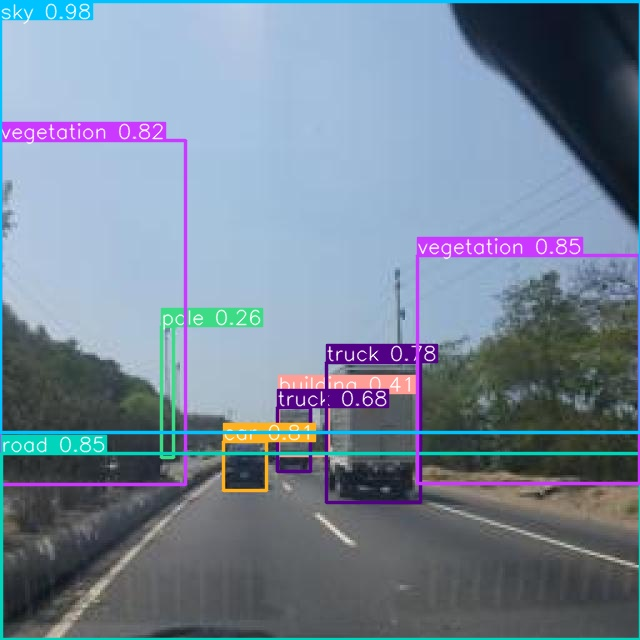



/content/runs/detect/predict/cologne_000030_000019_leftImg8bit_png.rf.5bdf96cb1e5356a899cdcbf31b75fe34.jpg


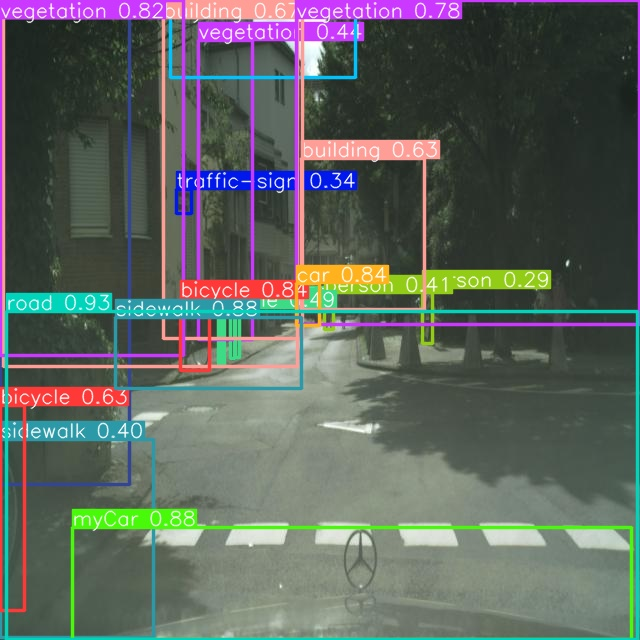



/content/runs/detect/predict/germany_road_30_png.rf.55f497c42aeb43a61445ff2c7a6298f8.jpg


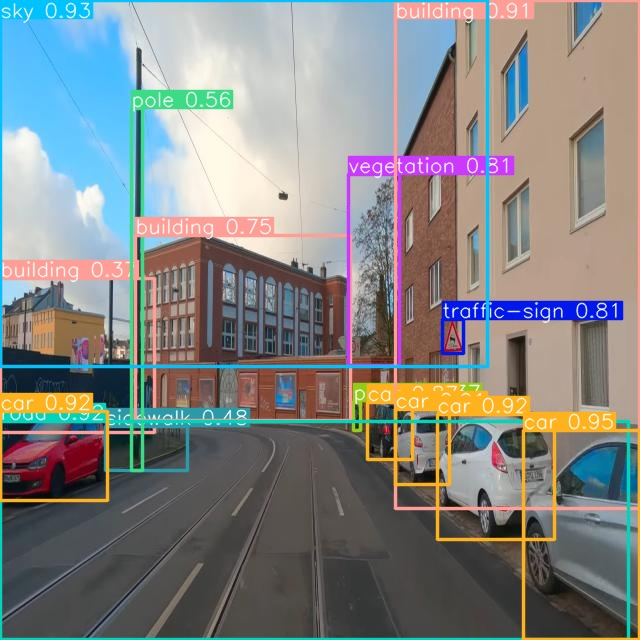



/content/runs/detect/predict/darmstadt_000045_000019_leftImg8bit_png.rf.dad3bbb5077087b645cb49fca90b6bb9.jpg


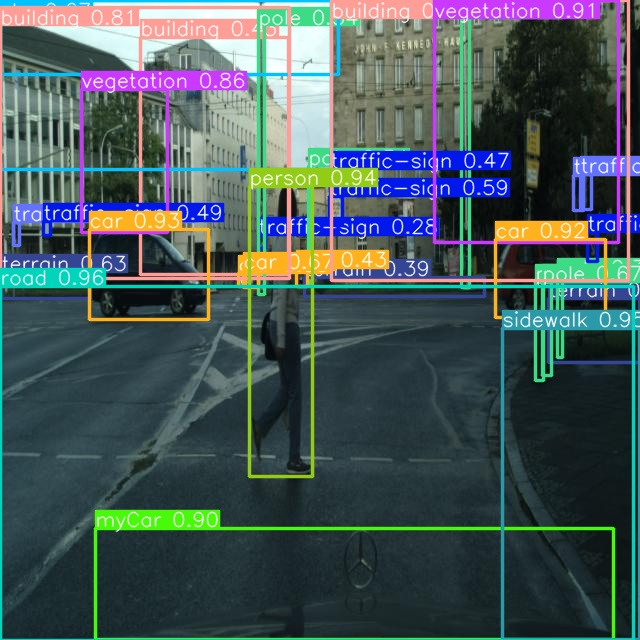



/content/runs/detect/predict/dry00015_jpg.rf.27e56b1c2358f31932b7d7cc3bdfa387.jpg


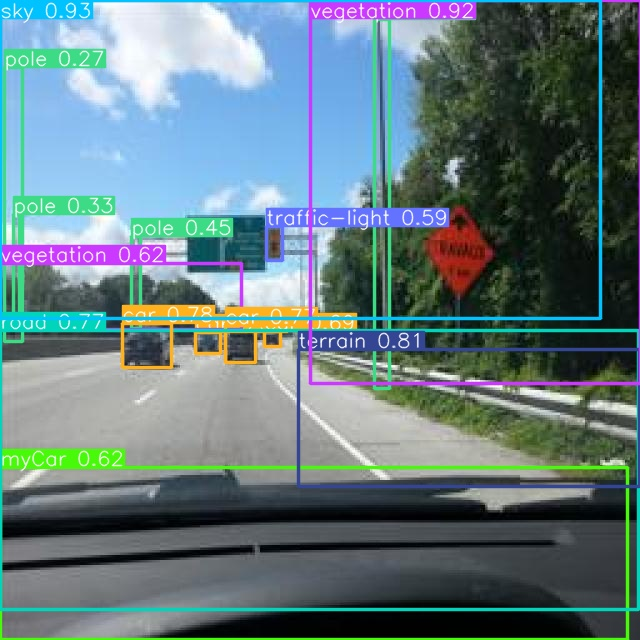



/content/runs/detect/predict/dry00041_jpg.rf.a41b11c2842263eebf96215968ff9cd0.jpg


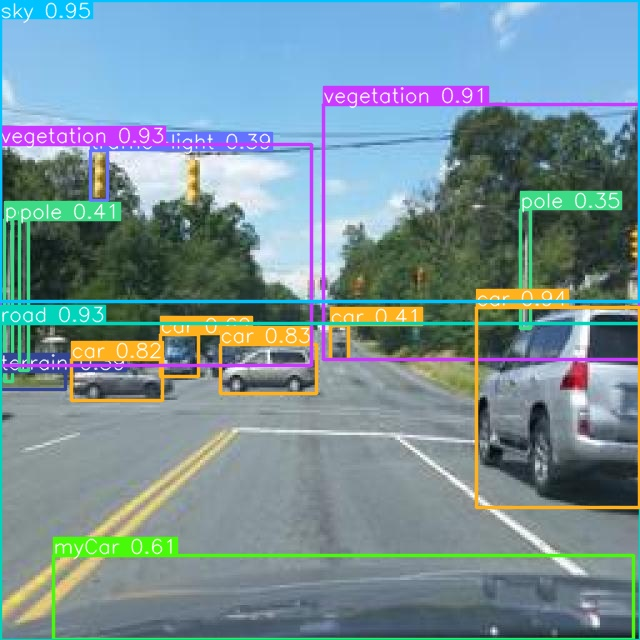

In [ ]:
for image_path in glob.glob(f'{HOME}/runs/detect/predict/*.jpg'):
      print(image_path)
      display(Image(filename=image_path, width=600))
      print("\n")

###Performing Object Detection with YOLOv8 on Training Images and Saving Results to JSON

In [ ]:
# Load the trained model
model = YOLO('/content/runs/detect/train/weights/best.pt')
# Define the path to the image or directory of images
image_path = '/content/object-detection-new-amina-dina-17/train/images'

# Run inference
results = model.predict(source=image_path, save=True)

# Extract predictions
objects_detected = []

# Iterate over results
for result in results:
    for box in result.boxes:
        # Extract class label, confidence, and bounding box coordinates
        label_id = int(box.cls[0])
        class_label = result.names[int(box.cls[0])]
        confidence = box.conf[0].item()
        bbox_coords = box.xyxy[0].tolist()

        # Append detected object info to list
        objects_detected.append({
            'label_id': label_id,
            'class_label': class_label,
            'confidence': confidence,
            'bbox': bbox_coords
        })

# Define path to save the JSON file
save_path = 'yolov8_detection_results.json'

# Save the detection results to a JSON file
with open(save_path, 'w') as f:
    json.dump(objects_detected, f)

print("YOLOv8 detection results saved successfully to:", save_path)



WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/818 /content/object-detection-new-amina-dina-17/train/images/02-11-2019_Traffic_Inbox_The_Red_Arrow_jpeg_jpg.rf.b4734ba9680e4ef1c5fdf1de67e61557.jpg: 800x800 11 cars, 12 poles, 1 road, 1 sky, 7 terrains, 6 traffic-lights, 8 traffic-signs, 4 trucks, 2 vegetations, 22.7ms
image 2/818 /content/object-detection-new-amina-dina-17/train/images/46A4JKG55AI6HDI4QVC7CCFWWA_jpg.rf.c585417ed0fb2124424e3f1047ac5f2c.jpg: 800x800 4 cars, 11 poles, 1 rider, 1 road, 1 sky, 7 traffic-lights, 5 traffic-signs, 2 vegetations, 22.6ms
image 3/818 /content/object-detection-new-amina-dina-17/train/images/IMG_1487_jpg.rf.2476c402c4a186304212da95b0990258.jpg: 800x800 1 building, 1 car, 3 poles, 1 road, 1 sky, 2 terrains, 2 traffic-lights, 1 vegetation, 22.5ms
image 4/818 /content/object-detection-new-amina-dina-17/train/images/IMG_1487_jpg.rf.312ae5ca836bee772a1c311a09ccd12a.jpg: 800x800 1 building, 1 car, 2 poles, 1 road, 1 sky, 4 terrains, 2 traffic-lights, 1

YOLOv8 detection results saved successfully to: yolov8_detection_results.json


###Performing Object Detection with YOLOv8 on Validation Images and Saving Results to JSON

In [ ]:
# Load the trained model
model = YOLO('/content/runs/detect/train/weights/best.pt')
# Define the path to the image or directory of images
image_path = '/content/object-detection-new-amina-dina-17/valid/images'

# Run inference
results = model.predict(source=image_path, save=True)

# Extract predictions
objects_detected = []

# Iterate over results
for result in results:
    for box in result.boxes:
        # Extract class label, confidence, and bounding box coordinates
        label_id = int(box.cls[0])
        class_label = result.names[int(box.cls[0])]
        confidence = box.conf[0].item()
        bbox_coords = box.xyxy[0].tolist()

        # Append detected object info to list
        objects_detected.append({
            'label_id': label_id,
            'class_label': class_label,
            'confidence': confidence,
            'bbox': bbox_coords
        })

# Define path to save the JSON file
save_path = 'yolov8_detection_val_results.json'

# Save the detection results to a JSON file
with open(save_path, 'w') as f:
    json.dump(objects_detected, f)

print("YOLOv8 detection results saved successfully to:", save_path)



image 1/95 /content/object-detection-new-amina-dina-17/valid/images/bremen_000003_000019_leftImg8bit_png.rf.9dede9f5bd885986692c4c12e94ef14e.jpg: 800x800 3 bicycles, 5 buildings, 2 cars, 1 myCar, 1 person, 2 poles, 1 rider, 1 road, 1 sidewalk, 1 sky, 1 train, 1 truck, 3 vegetations, 22.5ms
image 2/95 /content/object-detection-new-amina-dina-17/valid/images/cologne_000010_000019_leftImg8bit_png.rf.b4e622478a606a6cc7dab1a61c8e8b9c.jpg: 800x800 3 buildings, 17 cars, 1 myCar, 2 persons, 5 poles, 1 road, 1 sidewalk, 1 sky, 8 terrains, 5 traffic-signs, 4 vegetations, 26.5ms
image 3/95 /content/object-detection-new-amina-dina-17/valid/images/cologne_000030_000019_leftImg8bit_png.rf.31724821677afb23463f31b27919acba.jpg: 800x800 2 bicycles, 3 buildings, 1 car, 1 myCar, 3 persons, 4 poles, 1 road, 2 sidewalks, 1 sky, 1 terrain, 1 traffic-sign, 4 vegetations, 22.5ms
image 4/95 /content/object-detection-new-amina-dina-17/valid/images/cologne_000031_000019_leftImg8bit_png.rf.13f5e15eb91ded118a1f10

YOLOv8 detection results saved successfully to: yolov8_detection_val_results.json


###Performing Object Detection with YOLOv8 on Test Images and Saving Results to JSON

In [ ]:
# Load the trained model
model = YOLO('/content/runs/detect/train/weights/best.pt')
# Define the path to the image or directory of images
image_path = '/content/object-detection-new-amina-dina-17/test/images'

# Run inference
results = model.predict(source=image_path, save=True)

# Extract predictions
objects_detected = []

# Iterate over results
for result in results:
    for box in result.boxes:
        # Extract class label, confidence, and bounding box coordinates
        label_id = int(box.cls[0])
        class_label = result.names[int(box.cls[0])]
        confidence = box.conf[0].item()
        bbox_coords = box.xyxy[0].tolist()

        # Append detected object info to list
        objects_detected.append({
            'label_id': label_id,
            'class_label': class_label,
            'confidence': confidence,
            'bbox': bbox_coords
        })

# Define path to save the JSON file
save_path = 'yolov8_detection_test_results.json'

# Save the detection results to a JSON file
with open(save_path, 'w') as f:
    json.dump(objects_detected, f)

print("YOLOv8 detection results saved successfully to:", save_path)



image 1/41 /content/object-detection-new-amina-dina-17/test/images/MnDOT-traffic-signals-at-intersection_jpg.rf.e9c64e1e5c80ac3a5edbeec6e933915a.jpg: 800x800 2 buildings, 4 cars, 1 person, 9 poles, 1 road, 1 sidewalk, 1 sky, 3 terrains, 10 traffic-lights, 5 traffic-signs, 3 trucks, 2 vegetations, 22.5ms
image 2/41 /content/object-detection-new-amina-dina-17/test/images/bfe07cf7-28db-44f1-ac2c-6e90c8008ed7-largeScale_MetroPolice_2_jpg.rf.efc6a8a655d56c6f178f52d0493465a3.jpg: 800x800 7 cars, 1 person, 5 poles, 1 road, 1 sky, 3 terrains, 2 traffic-lights, 5 traffic-signs, 1 truck, 4 vegetations, 22.6ms
image 3/41 /content/object-detection-new-amina-dina-17/test/images/bremen_000054_000019_leftImg8bit_png.rf.ef41a165ac9abc793296f65766af1e42.jpg: 800x800 7 bicycles, 2 buildings, 4 cars, 1 motorcycle, 1 myCar, 6 persons, 10 poles, 2 riders, 1 road, 2 sidewalks, 1 sky, 3 traffic-signs, 2 vegetations, 22.5ms
image 4/41 /content/object-detection-new-amina-dina-17/test/images/cologne_000030_000

YOLOv8 detection results saved successfully to: yolov8_detection_test_results.json


###Mount Google Drive

In [ ]:
drive.mount('/content/drive')

###Images Prediction and Saving

In [ ]:
image_1 = model.predict("/content/drive/MyDrive/Unseen Images /tubingen_000039_000019_leftImg8bit.png" ,save=True)


image 1/1 /content/drive/MyDrive/Unseen Images /tubingen_000039_000019_leftImg8bit.png: 416x800 1 building, 15 cars, 1 myCar, 4 poles, 1 road, 1 sky, 1 traffic-sign, 9 vegetations, 16.2ms
Speed: 4.1ms preprocess, 16.2ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 800)
Results saved to runs/detect/predict2


In [ ]:
image_2 = model.predict("/content/drive/MyDrive/Unseen Images /tubingen_000035_000019_leftImg8bit.png" ,save=True)


image 1/1 /content/drive/MyDrive/Unseen Images /tubingen_000035_000019_leftImg8bit.png: 416x800 3 bicycles, 1 building, 1 myCar, 2 poles, 3 riders, 1 road, 1 sidewalk, 3 traffic-signs, 15.4ms
Speed: 2.8ms preprocess, 15.4ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 800)
Results saved to runs/detect/predict2


In [ ]:
image_3 = model.predict("/content/drive/MyDrive/Unseen Images /tubingen_000033_000019_leftImg8bit.png" ,save=True)


image 1/1 /content/drive/MyDrive/Unseen Images /tubingen_000033_000019_leftImg8bit.png: 416x800 3 bicycles, 9 buildings, 8 cars, 1 myCar, 1 pole, 1 road, 2 sidewalks, 2 terrains, 1 traffic-sign, 1 truck, 9 vegetations, 15.4ms
Speed: 2.8ms preprocess, 15.4ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 800)
Results saved to runs/detect/predict2


In [ ]:
image_4 = model.predict("/content/drive/MyDrive/Unseen Images /tubingen_000030_000019_leftImg8bit.png" ,save=True)


image 1/1 /content/drive/MyDrive/Unseen Images /tubingen_000030_000019_leftImg8bit.png: 416x800 4 buildings, 9 cars, 1 motorcycle, 1 myCar, 1 person, 4 poles, 1 road, 4 sidewalks, 1 sky, 2 terrains, 7 vegetations, 15.4ms
Speed: 2.7ms preprocess, 15.4ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 800)
Results saved to runs/detect/predict2


### image_1

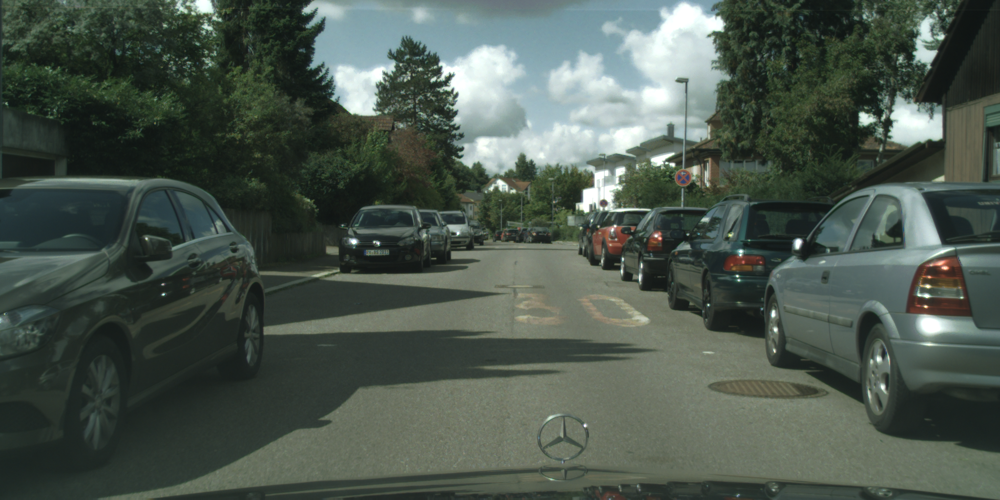

In [ ]:
Image(filename='/content/drive/MyDrive/Unseen Images /tubingen_000039_000019_leftImg8bit.png' ,width=800)

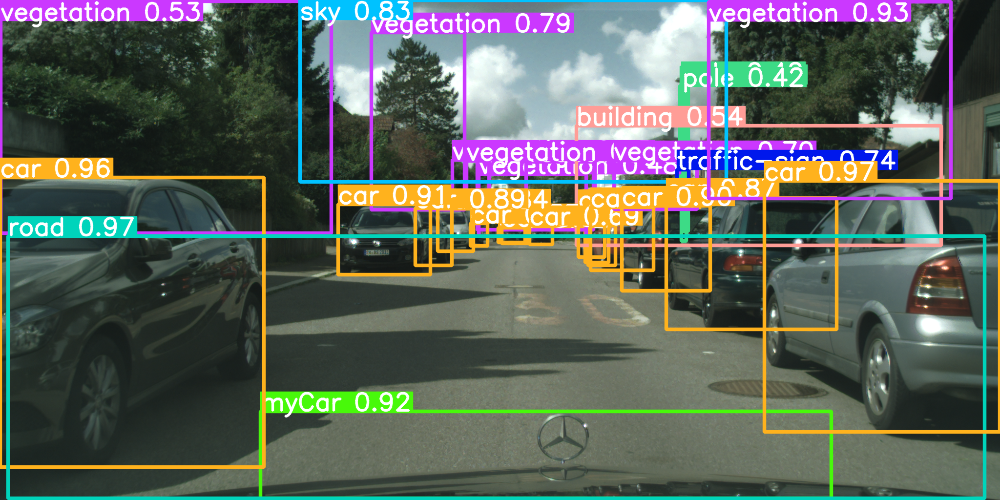

In [ ]:
Image(filename='/content/runs/detect/predict2/tubingen_000039_000019_leftImg8bit.png' ,width=800)

### image_2

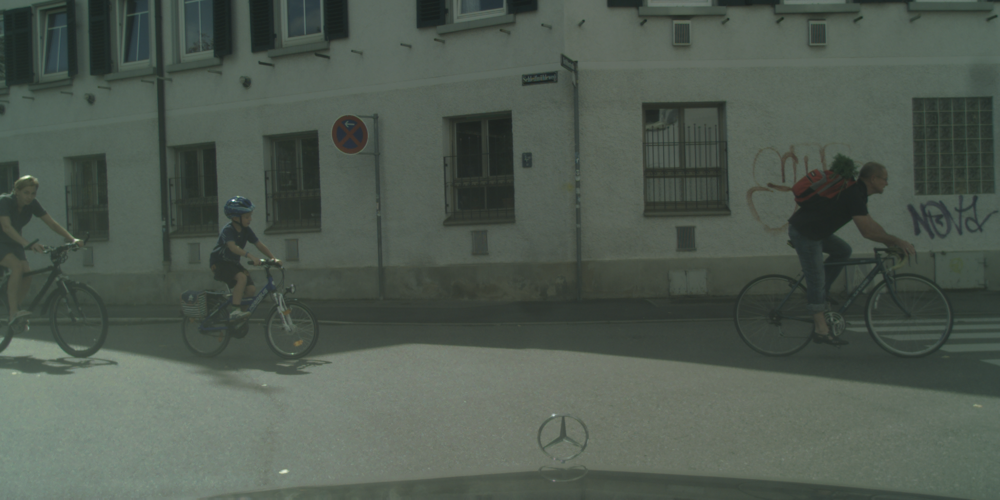

In [ ]:
Image(filename='/content/drive/MyDrive/Unseen Images /tubingen_000035_000019_leftImg8bit.png' ,width=800)

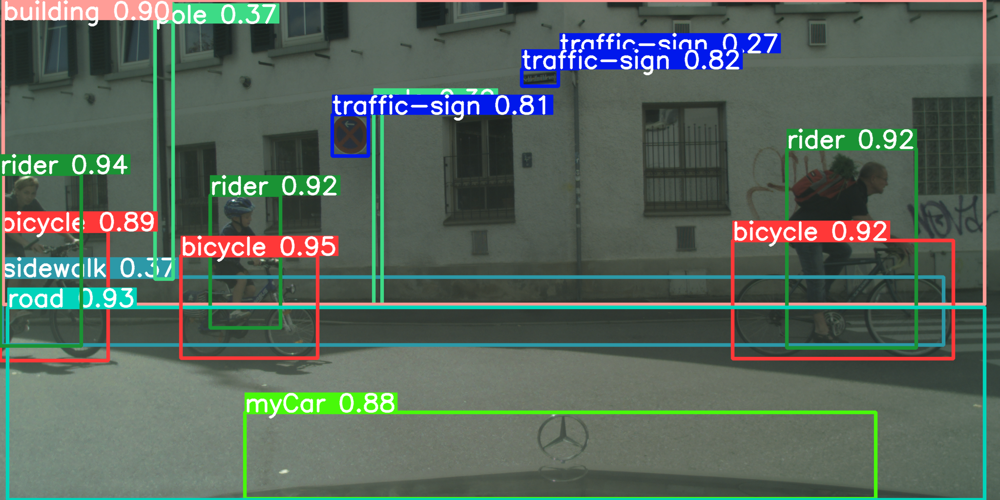

In [ ]:
Image(filename='/content/runs/detect/predict2/tubingen_000035_000019_leftImg8bit.png' ,width=800)

### image_3

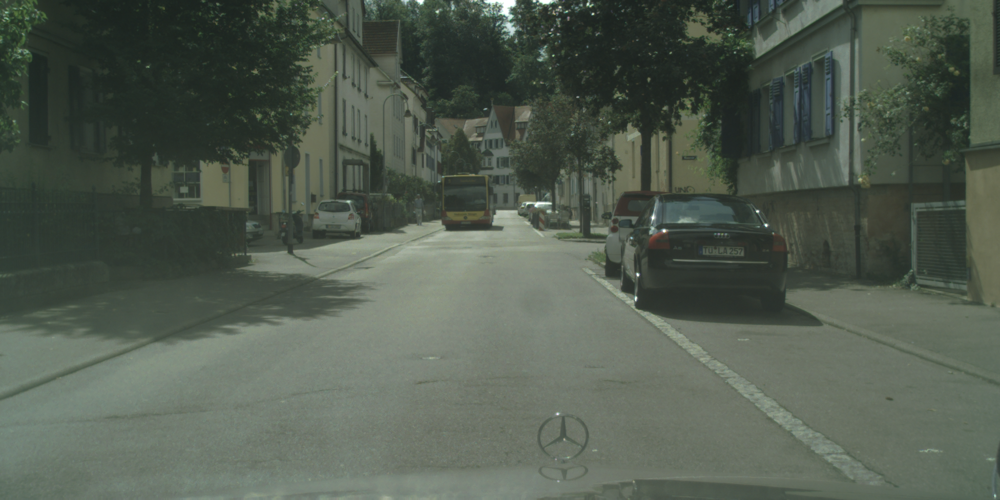

In [ ]:
Image(filename='/content/drive/MyDrive/Unseen Images /tubingen_000033_000019_leftImg8bit.png' ,width=800)

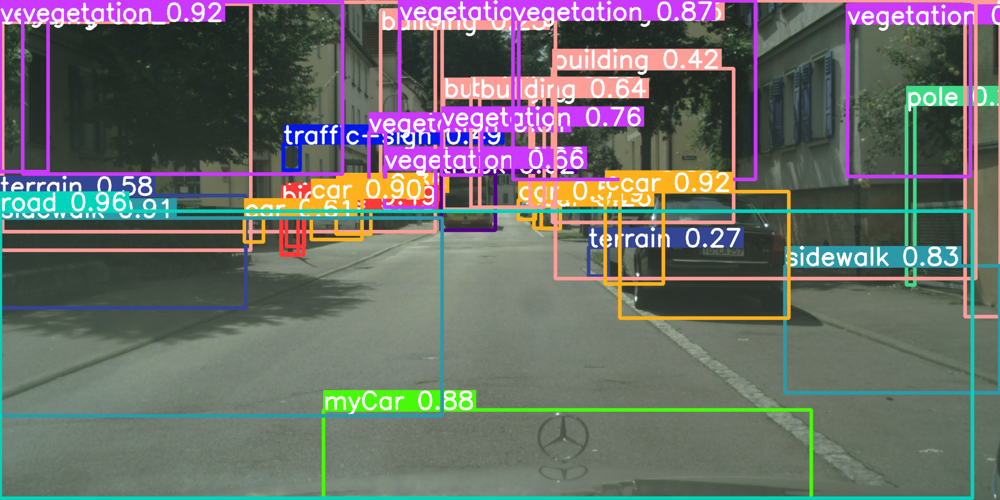

In [ ]:
Image(filename='/content/runs/detect/predict2/tubingen_000033_000019_leftImg8bit.png' ,width=800)

### image_4

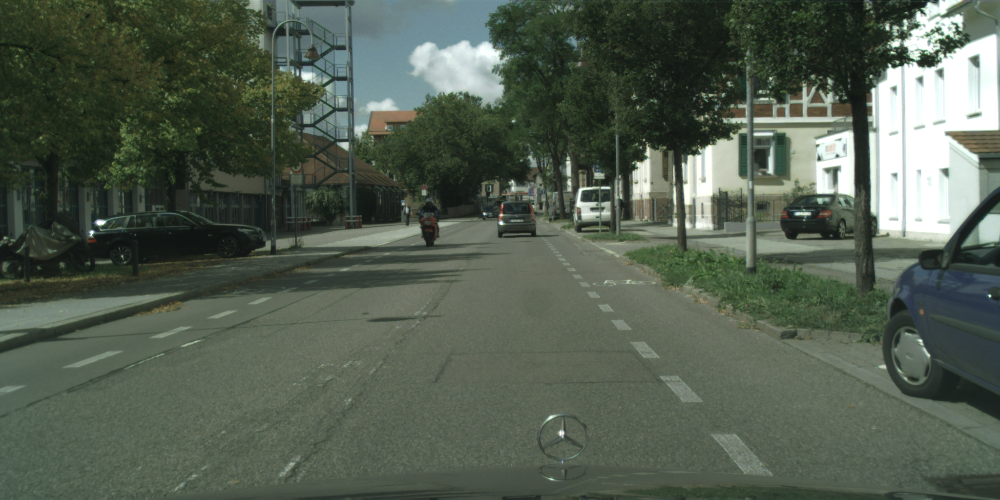

In [ ]:
Image(filename='/content/drive/MyDrive/Unseen Images /tubingen_000030_000019_leftImg8bit.png' ,width=800)

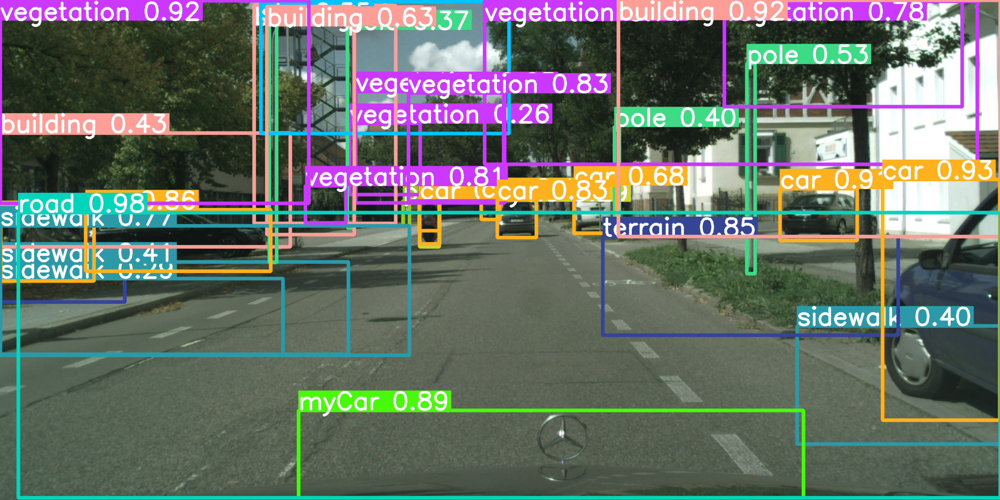

In [ ]:
Image(filename='/content/runs/detect/predict2/tubingen_000030_000019_leftImg8bit.png' ,width=800)

###YOLOv8s Object Detection on Video

In [ ]:
!yolo detect predict model=/content/best.pt source="/content/Germmay_Road_3.mp4" save=true

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11132550 parameters, 0 gradients, 28.5 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
video 1/1 (1/385) /content/Germmay_Road_3.mp4: 384x800 3 buildings, 3 cars, 1 pole, 1 road, 1 sky, 1 terrain, 1 traffic-sign, 3 vegetations, 135.7ms
video 1/1 (2/385) /content/Germmay_Road_3.mp4: 384x800 3 buildings, 3 cars, 1 pole, 1 road, 1 sky, 2 terrains, 1 traffic-sign, 3 vegetations, 13.7ms
video 1/1 (3/385) /content/Germmay_Road_3.mp4: 384x800 2 buildings, 4 cars, 1 pole, 1 road, 1 sky, 3 terrains, 1 traffic-sign, 3 vegetations, 13.6ms
video 1/1 (4/385) /content/Germmay_Road_3.mp4: 384x800 2 buildings, 3 cars, 1 pole, 1 road, 1 sky, 3 terrains, 1 traffic-sign, 3 vegetations, 13.6ms
video 1/1 (5/385) /content/Germmay_Road_3.mp4: 384x800 2 buildings, 3 cars, 1 pole, 1 road, 1 sky, 2 terrains, 1 traffic-sign, 3 vegetations, 13.6ms
video 1/1 (6/385) /content/Germmay_Road_3.m

###Convert AVI to MP4 with FFmpeg

In [ ]:
!ffmpeg -i "/content/runs/detect/predict2/Germmay_Road_3.avi" -vcodec libx264 "Final.mp4"

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab